In [83]:
from mpmath import mpf, mp
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
mp.dps = 3
# load data
filepath = '../data/roots_200'
roots = pd.read_csv(filepath+'.csv')

# Load Data from Roots File and from Polynomial Metadata Files

In [2]:
xstrings = roots['real'].to_numpy()
ystrings = roots['imaginary'].to_numpy()
qstrings = roots['q'].to_numpy()
pstrings = roots['p'].to_numpy()
xs = []
ys = []
qs = []
es = []
ps = []
for x in xstrings:
    if x not in roots.columns:
        xs.append(mpf(x))
for y in ystrings:
    if y not in roots.columns:
        ys.append(mpf(y))
for q in qstrings:
    if q not in roots.columns:
        qs.append(float(q))
for p in pstrings:
    if p not in roots.columns:
        ps.append(float(p))

In [94]:
# load levels array
poly_filepath = 'data/q_to_denom_200'
levels = pd.read_csv(poly_filepath+'levels.csv')
levels.rename(columns={'Unnamed: 0':'[p,q]'},inplace=True)
levels.set_index('[p,q]', inplace=True)

In [99]:
# iterate through roots lists of p and q to create levels for each root
# this is likely horribly inefficient, as we have 46,000+ roots.
recursion_levels = []
for p,q in zip(ps,qs):
    recursion_levels.append(int(levels.loc[f'[{int(p)},{int(q)}]']))

In [102]:
# load gamma array
gamma_df = pd.read_csv(poly_filepath+'gammas.csv')
gamma_df.rename(columns={'Unnamed: 0':'[p,q]'},inplace=True)
gamma_df.set_index('[p,q]', inplace=True)

In [105]:
# iterate through roots llists of p and q to create levels for each root
# this is likely horribly inefficient, as we have 46,000+ roots.
gammas = []
for p,q in zip(ps,qs):
    gammas.append([gamma_df.loc[f'[{int(p)},{int(q)}]']['gamma p'],gamma_df.loc[f'[{int(p)},{int(q)}]']['gamma q']])

In [147]:
def plot_roots(x_passed,y_passed,colors,lim=1, title=""):
    # Plots roots colored by ratio. Adds the negative of each root to give the symmetric cauliflower.
    x_passed = np.array(x_passed)
    y_passed = np.array(y_passed)
    colors = np.array(colors)
    xnegs = -1*x_passed
    x_double = np.concatenate([x_passed, xnegs], axis=0)
    y_double = np.concatenate([y_passed, y_passed], axis=0)
    colors = np.concatenate([colors,colors],axis=0)
    fig, axs = plt.subplots(1,figsize=(20,20))
    s = axs.scatter(x_double,y_double, c=colors, s=1)
    plt.xlim(-lim,lim)
    plt.ylim(-lim,lim)
    fig.colorbar(s)
    axs.set_title(title)
    plt.show()
def sort_by_ratio(ps, qs, xs, ys, min_ratio = 0, max_ratio = 0.5, lim=1):
    # plots only the roots for which the ratio p/q is less than a given threshold
    ratio = np.array(ps)/np.array(qs)
    xs = np.array(xs)
    ys = np.array(ys)
    bigger_than = (ratio >= min_ratio).astype(int)
    less_than = (ratio <= max_ratio).astype(int)
    indices = np.multiply(np.arange(0,len(ratio)),np.multiply(bigger_than,less_than))
    print(indices)
    indices = indices[indices>0]
    print(len(indices))
    new_ratios = ratio[indices]
    xis = xs[indices]
    yis = ys[indices]
    plot_roots(xis, yis, new_ratios,lim=lim, title=f"Roots with {min_ratio}<p/q<{max_ratio}")

In [ ]:
# add metadata to roots file
roots_enhanced = roots.assign(gamma = gammas)

roots_enhanced.assign(depth = recursion_levels)

In [167]:
roots_enhanced.to_csv('data/roots_200_enhanced.csv')

# Plot Roots colored by level

In [139]:
depths = np.array(recursion_levels)

len x (927664,). y (927664,), colors (927664,)


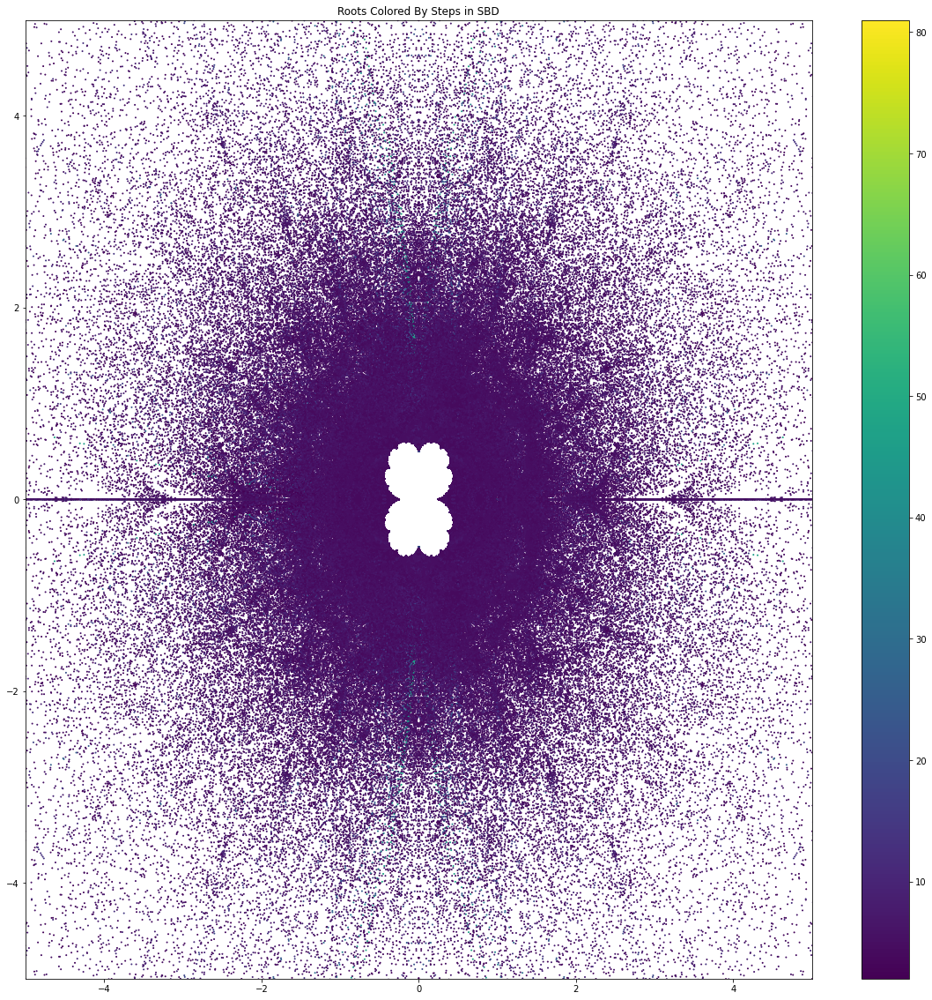

In [136]:
plot_roots(xs,ys,recursion_levels,title="Roots Colored By Steps in SBD",lim=5)

This suggests that the depth in the stern brocot diagram isn't meaningful, or at least that the points with a depth of more than ten are generally covered up by points with a smaller depth. (Though that is odd; the higher depths should be more common).

In [142]:
def sort_by_depth(xs, ys, depths, min_depth = 0, max_depth = 0.5, lim=1):
    # plots only the roots for which the ratio p/q is less than a given threshold
    xs = np.array(xs)
    ys = np.array(ys)
    bigger_than = (depths >= min_depth).astype(int)
    less_than = (depths <= max_depth).astype(int)
    indices = np.multiply(np.arange(0,len(depths)),np.multiply(bigger_than,less_than))
    print(indices)
    indices = indices[indices>0]
    print(len(indices))
    new_ratios = depths[indices]
    xis = xs[indices]
    yis = ys[indices]
    plot_roots(xis, yis, new_ratios,lim=lim, title=f"Roots with {min_depth}<depth<{max_depth}")

[0 0 0 ... 0 0 0]
3323


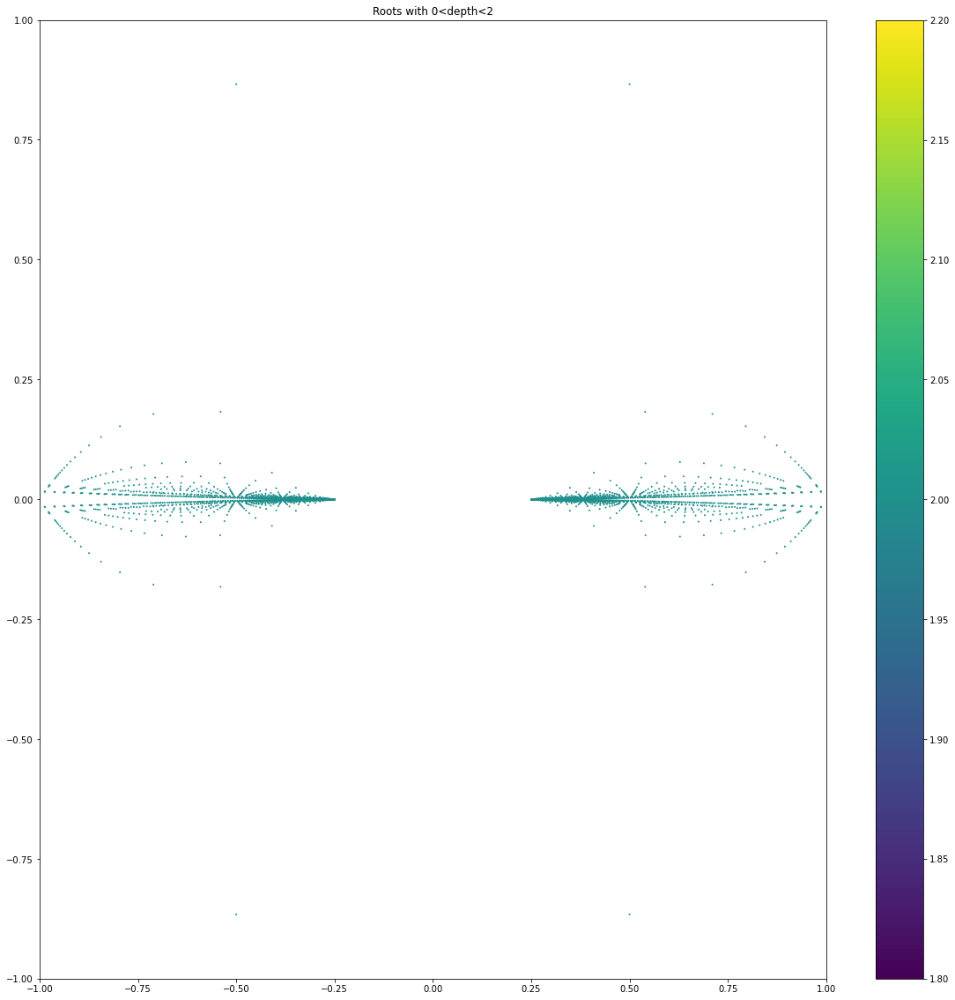

In [148]:
sort_by_depth(xs,ys,depths,min_depth=0, max_depth=2)

[0 1 2 ... 0 0 0]
31560
len x (63120,). y (63120,), colors (63120,)


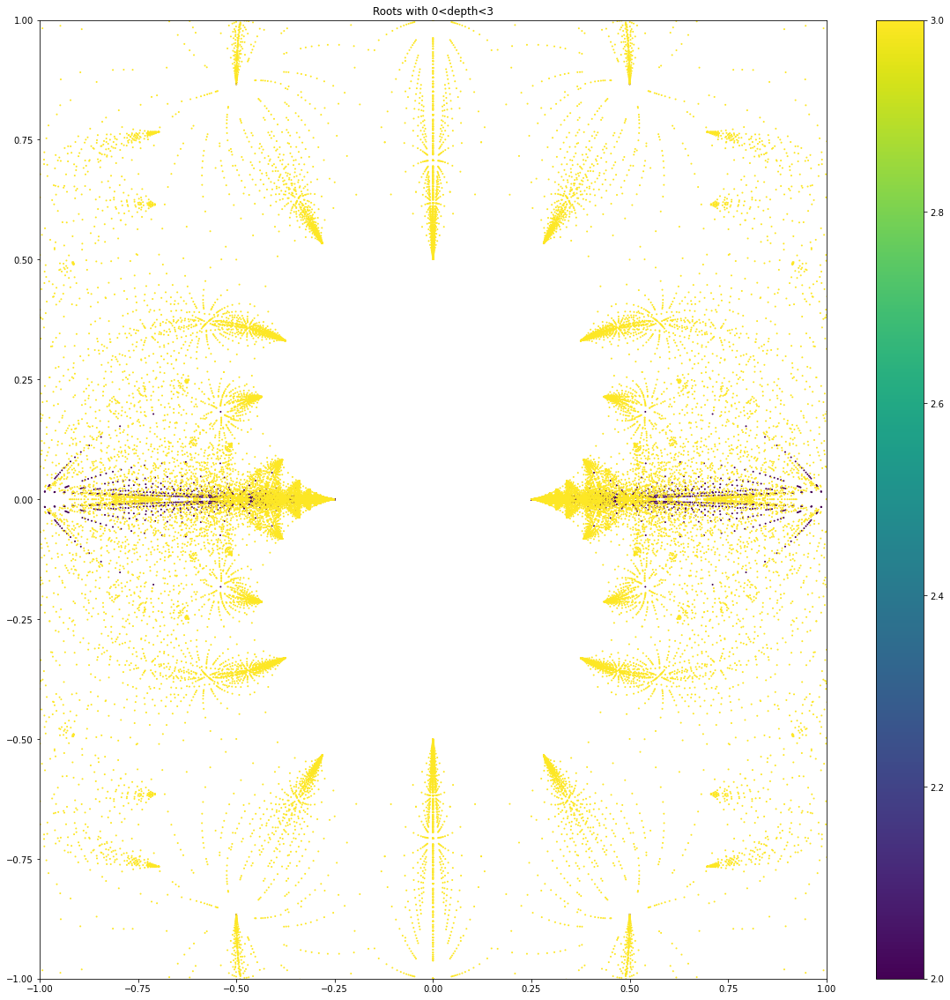

In [145]:
sort_by_depth(xs,ys,depths,min_depth=0, max_depth=3)

[0 1 2 ... 0 0 0]
104407


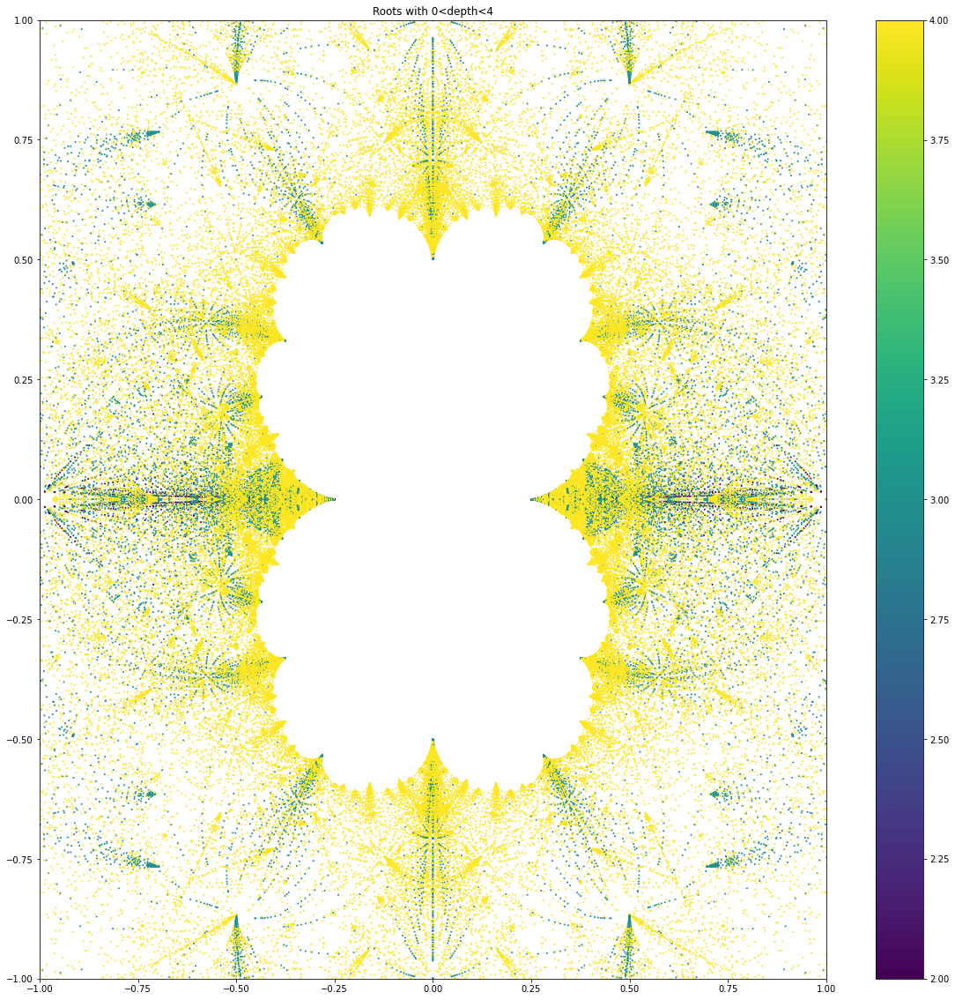

In [149]:
sort_by_depth(xs,ys,depths,min_depth=0, max_depth=4)

[0 1 2 ... 0 0 0]
194967


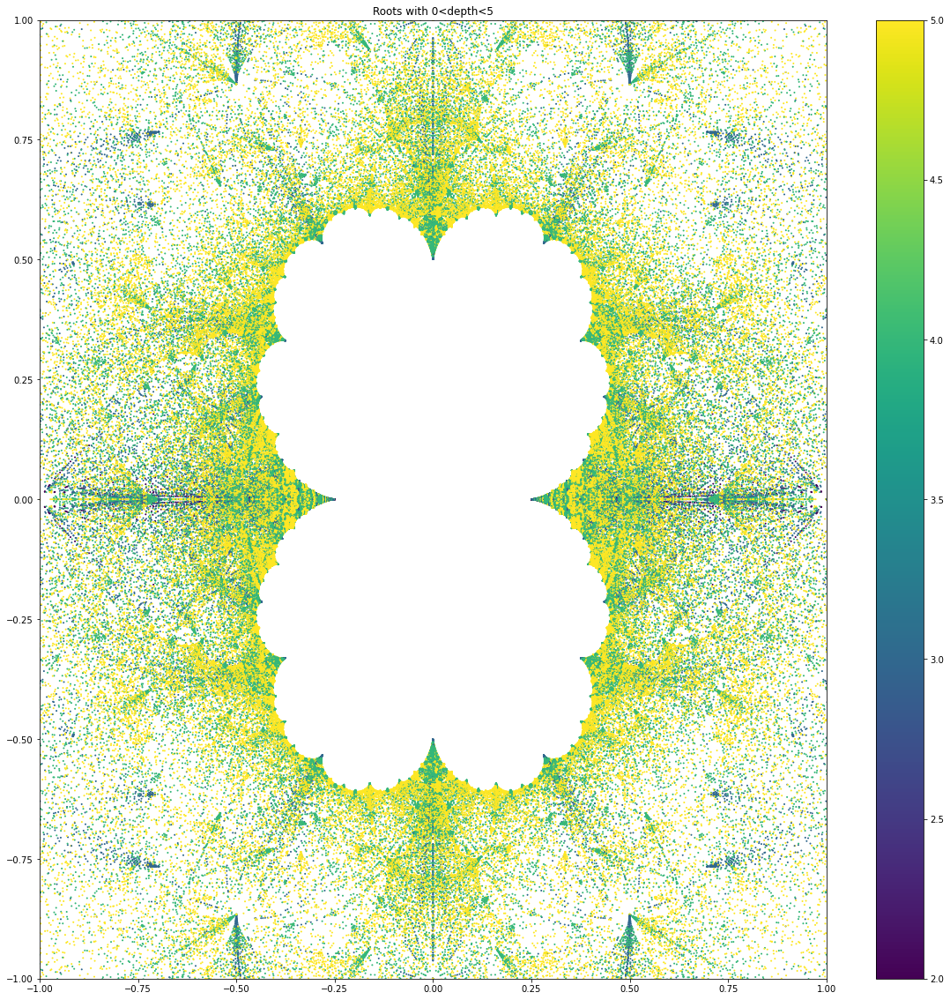

In [150]:
sort_by_depth(xs,ys,depths,min_depth=0, max_depth=5)

# Plot Roots Colored by Gamma

In [154]:
# convert gammas into a list of floats
gamma_floats = [g[0]/g[1] for g in gammas]

gamma_floats = np.array(gamma_floats)

In [152]:
def sort_by_gamma(xs, ys, gammas, min_gamma = 0, max_gamma = 0.5, lim=1):
    xs = np.array(xs)
    ys = np.array(ys)
    bigger_than = (gammas >= min_gamma).astype(int)
    less_than = (gammas <= max_gamma).astype(int)
    indices = np.multiply(np.arange(0,len(gammas)),np.multiply(bigger_than,less_than))
    print(indices)
    indices = indices[indices>0]
    print(len(indices))
    new_ratios = gammas[indices]
    xis = xs[indices]
    yis = ys[indices]
    plot_roots(xis, yis, new_ratios,lim=lim, title=f"Roots with {min_gamma}<gamma<{max_gamma}")

[     0      1      2 ... 463829 463830 463831]
463831


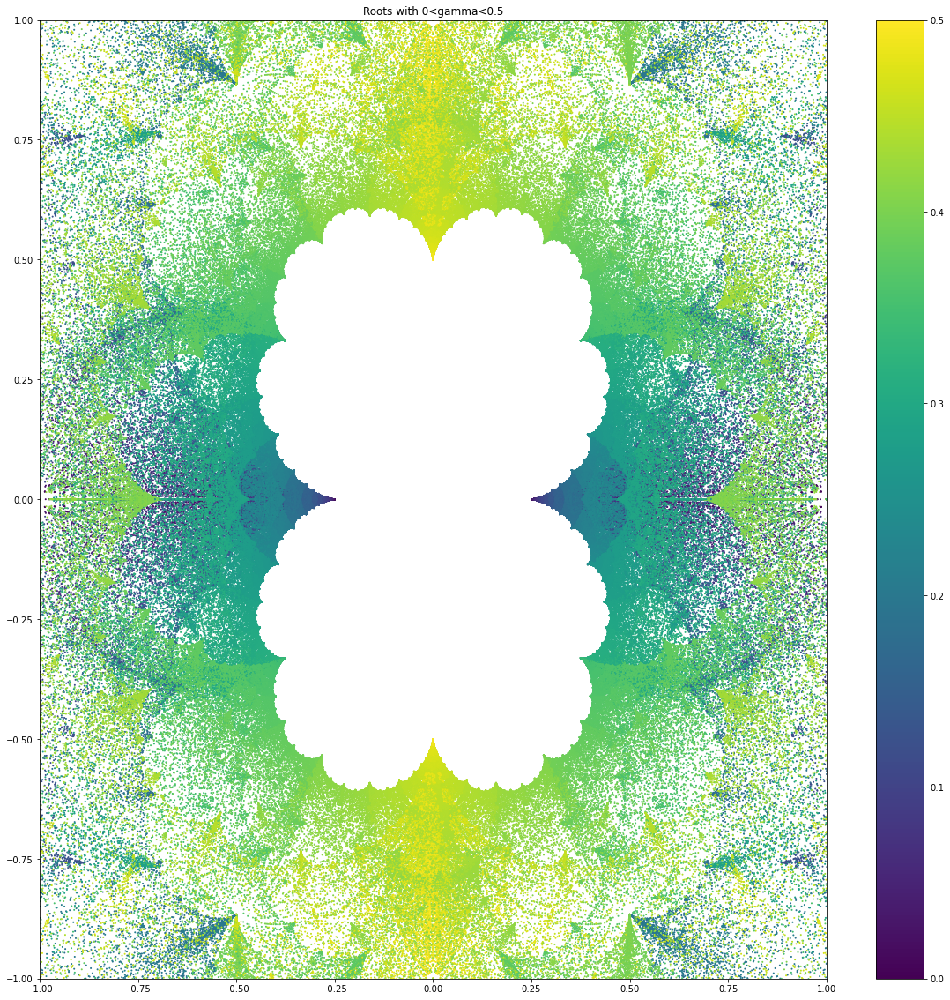

In [155]:
sort_by_gamma(xs,ys,gamma_floats,min_gamma=0, max_gamma=0.5,lim=1)

Of course, this closely approximates the graph colored by p/q for large samplings.

[0 0 0 ... 0 0 0]
18992


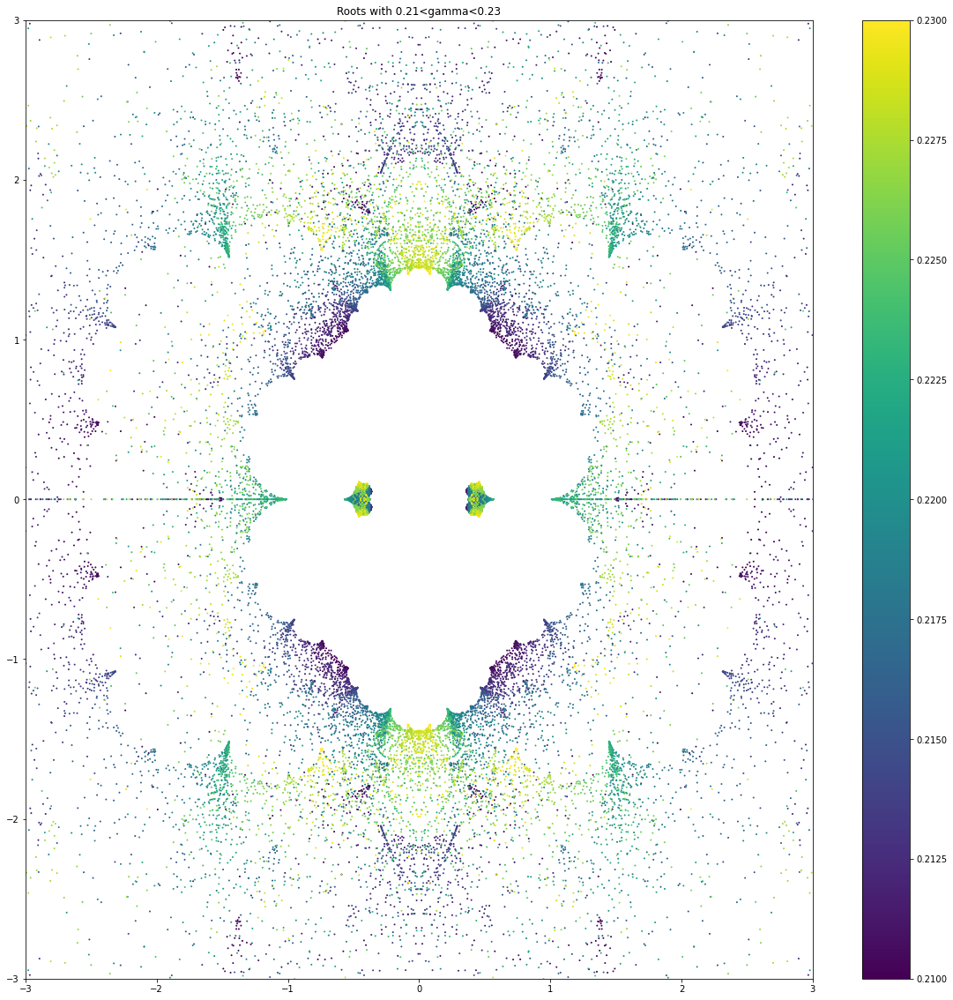

In [161]:
sort_by_gamma(xs,ys,gamma_floats,min_gamma=0.21, max_gamma=0.23,lim=3)

# Plot Roots for Various thresholds of p/q

[     0      1      2 ... 463829 463830 463831]
463831


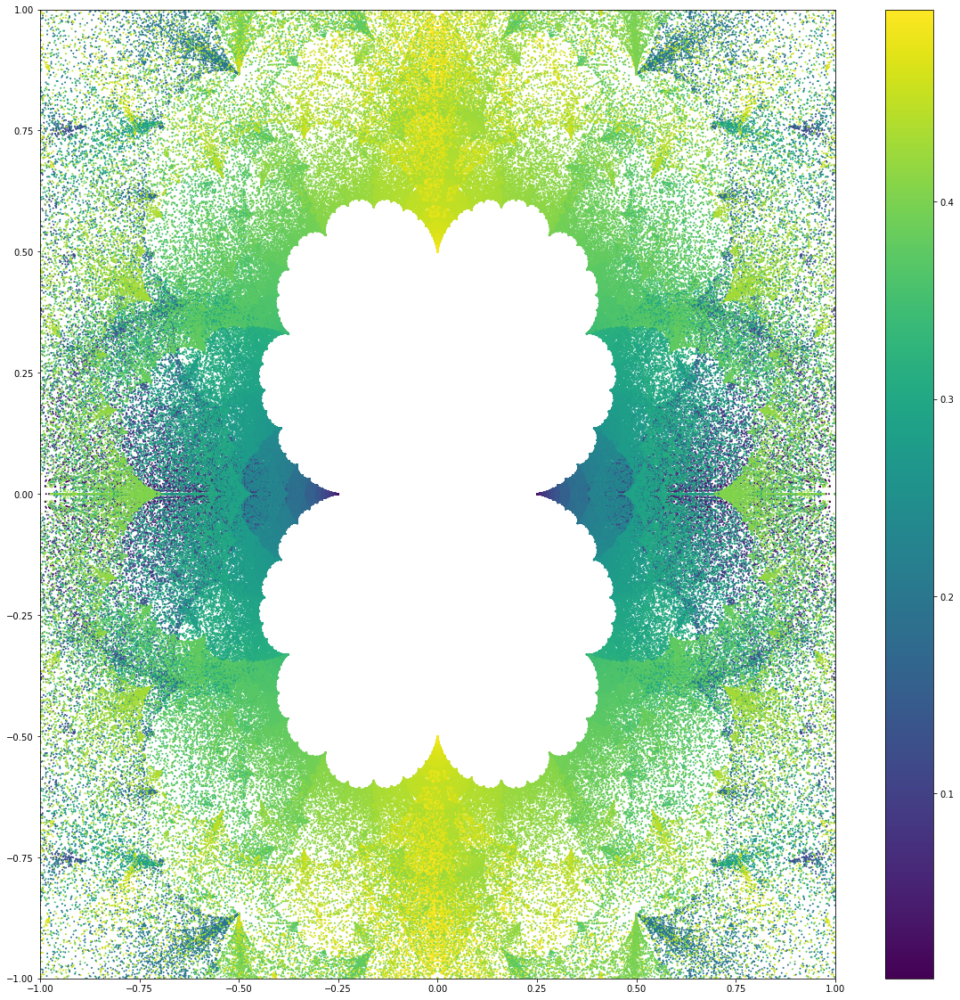

In [54]:
sort_by_ratio(ps,qs,xs,ys,min_ratio=0,max_ratio=0.5)

[0 0 0 ... 0 0 0]
38399


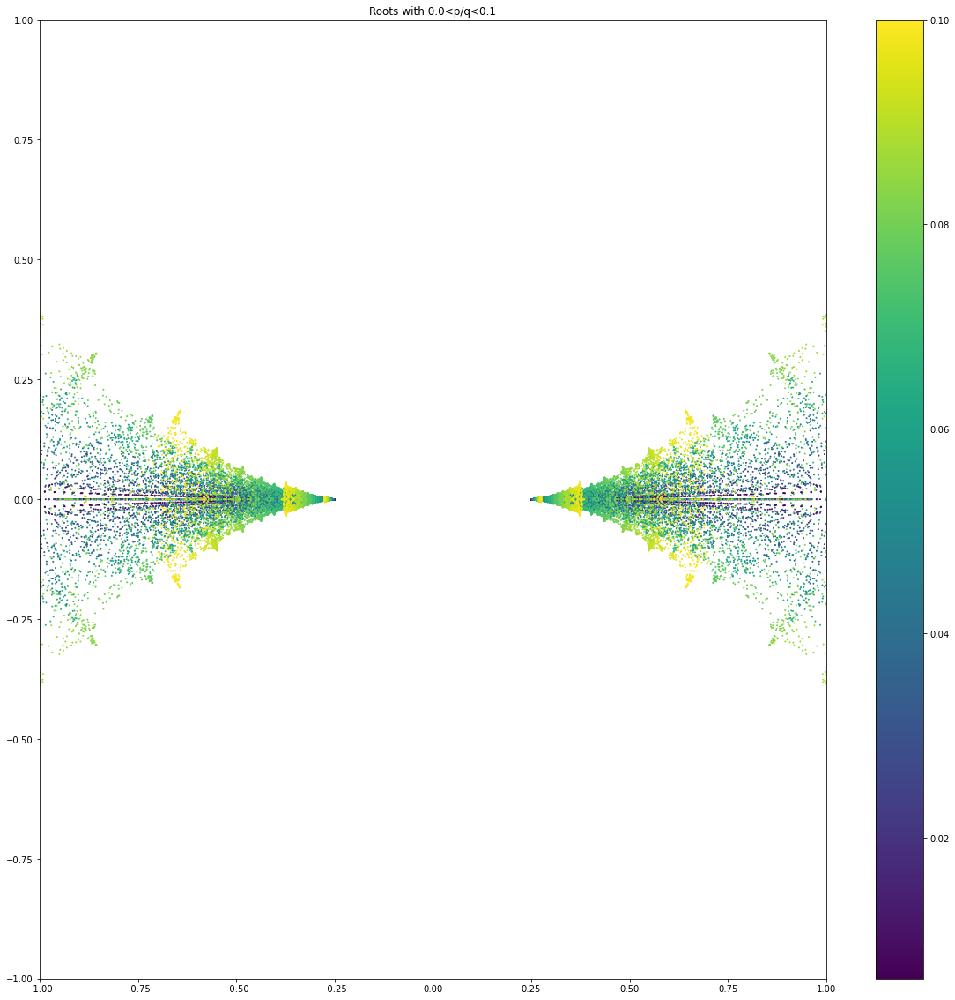

In [61]:
sort_by_ratio(ps,qs,xs,ys,min_ratio=0.0, max_ratio=0.1)

[0 0 0 ... 0 0 0]
38399


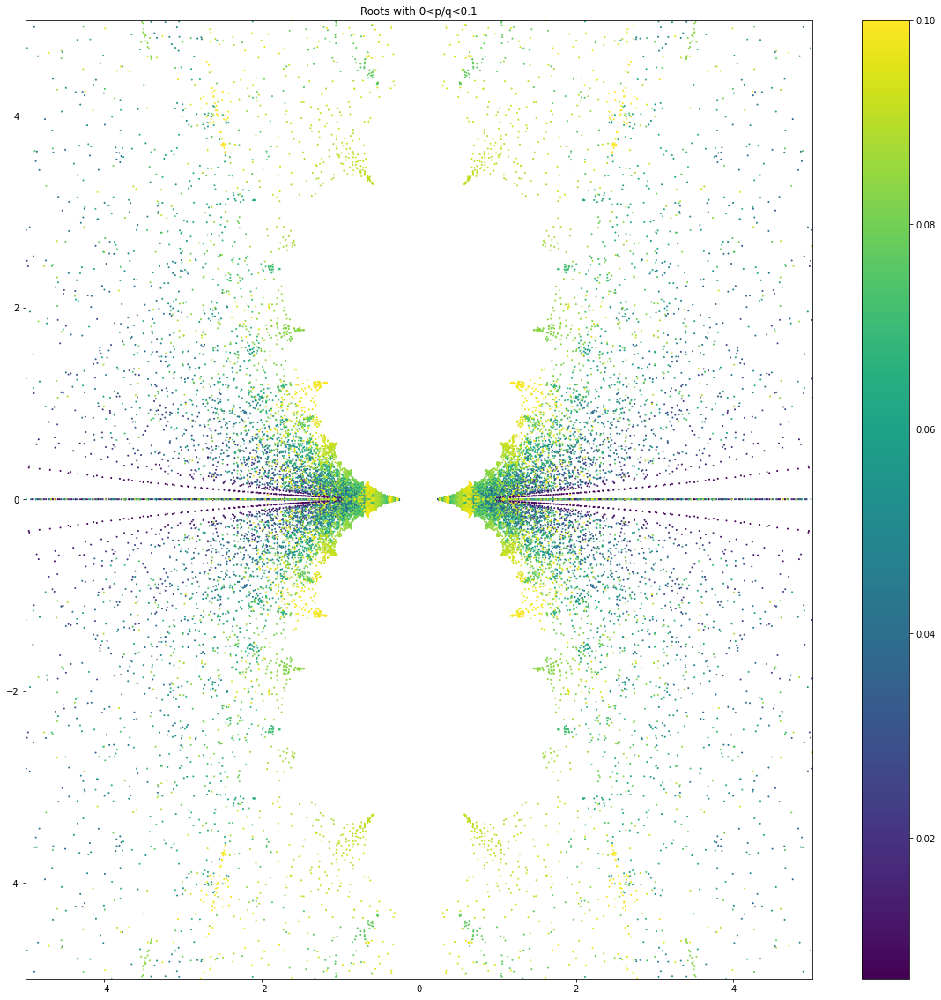

In [76]:
sort_by_ratio(ps,qs,xs,ys,min_ratio=0,max_ratio=0.1,lim=5)

[0 0 2 ... 0 0 0]
67016


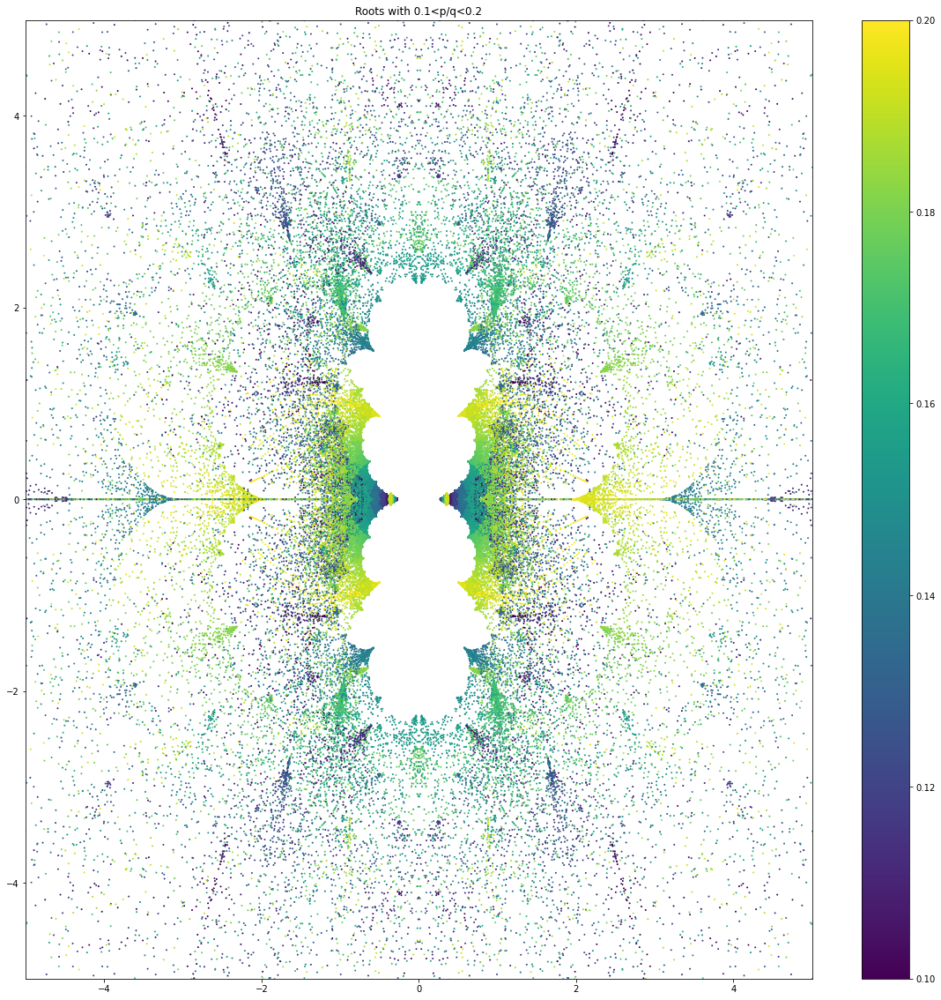

In [75]:
sort_by_ratio(ps,qs,xs,ys,min_ratio=0.1,max_ratio=0.2,lim=5)

[0 1 2 ... 0 0 0]
104163


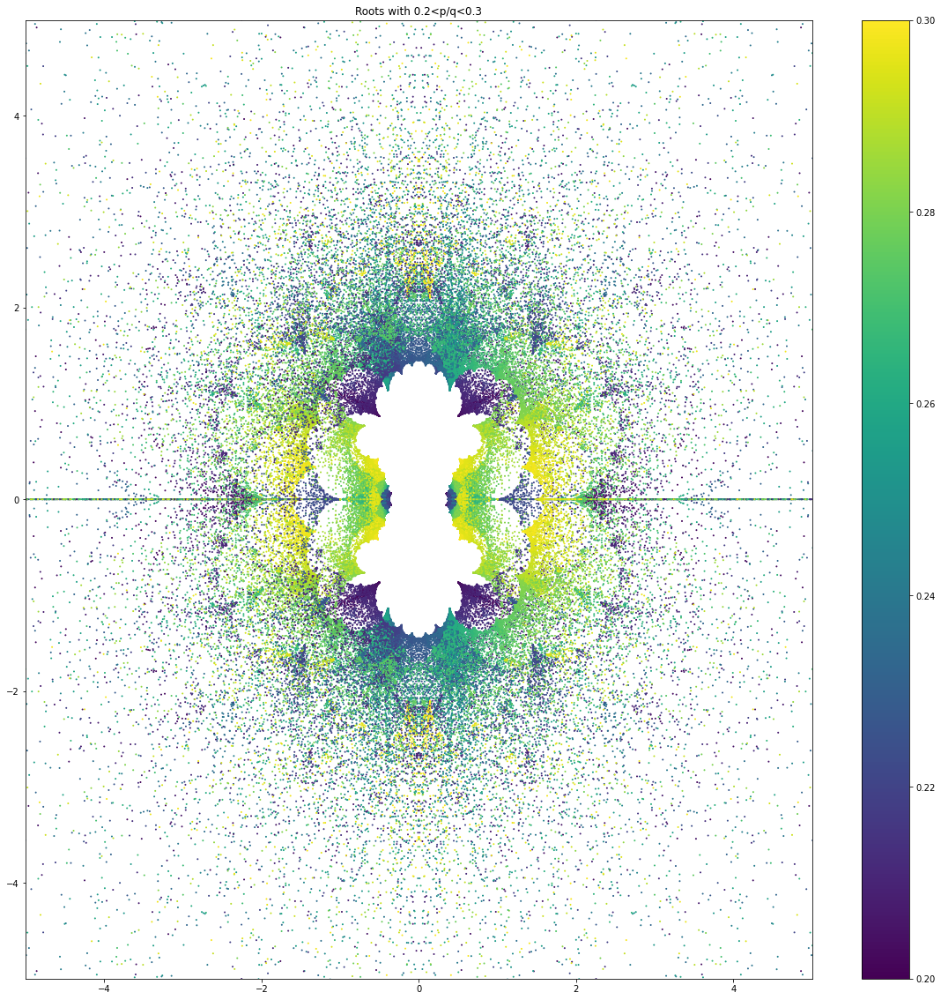

In [65]:
sort_by_ratio(ps,qs,xs,ys,min_ratio=0.2,max_ratio=0.3,lim=5)

[0 0 2 ... 0 0 0]
8235


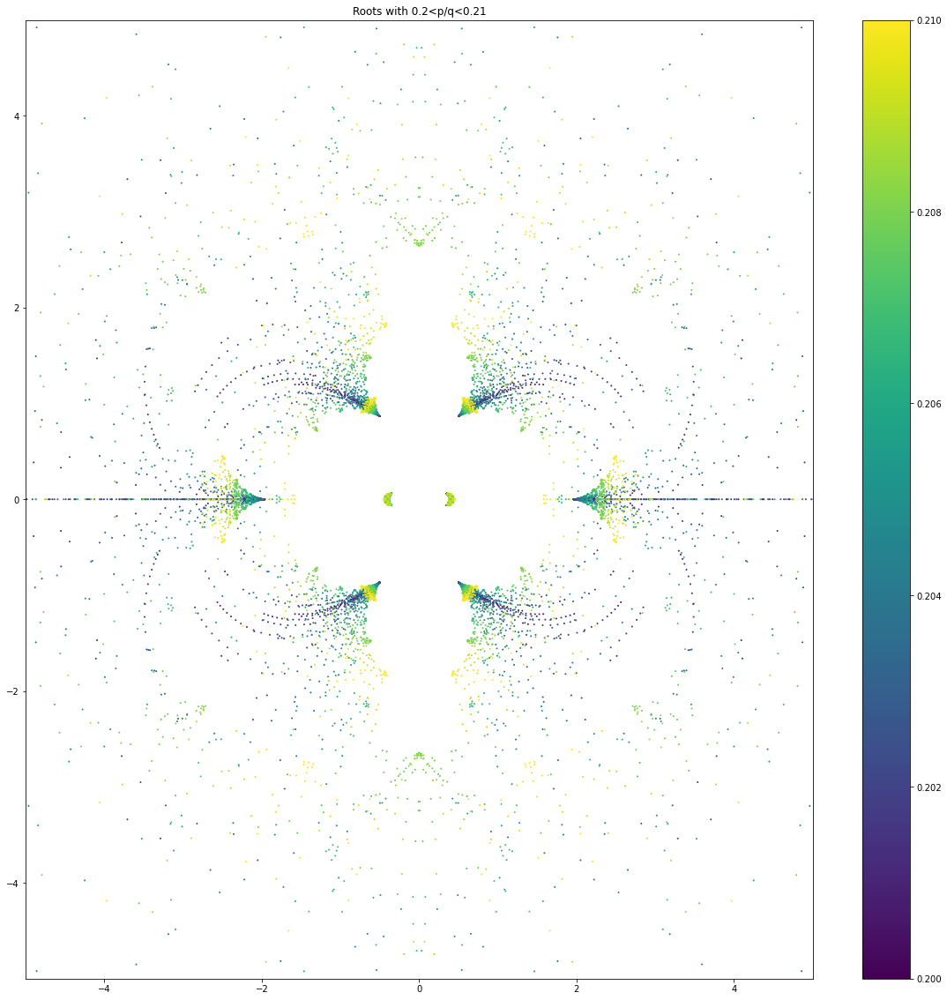

In [69]:
sort_by_ratio(ps,qs,xs,ys,min_ratio=0.2,max_ratio=0.21,lim=5)

[0 0 0 ... 0 0 0]
25638


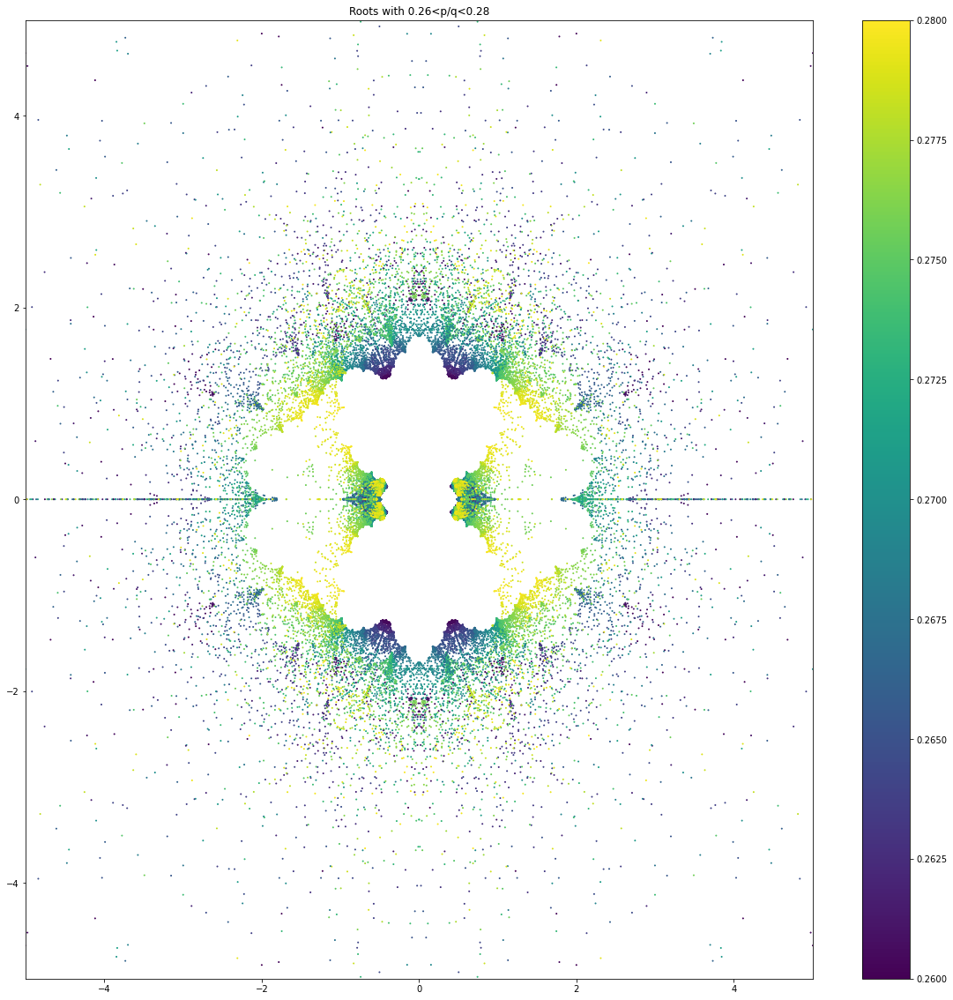

In [71]:
sort_by_ratio(ps,qs,xs,ys,min_ratio=0.26,max_ratio=0.28,lim=5)

[0 0 0 ... 0 0 0]
134466


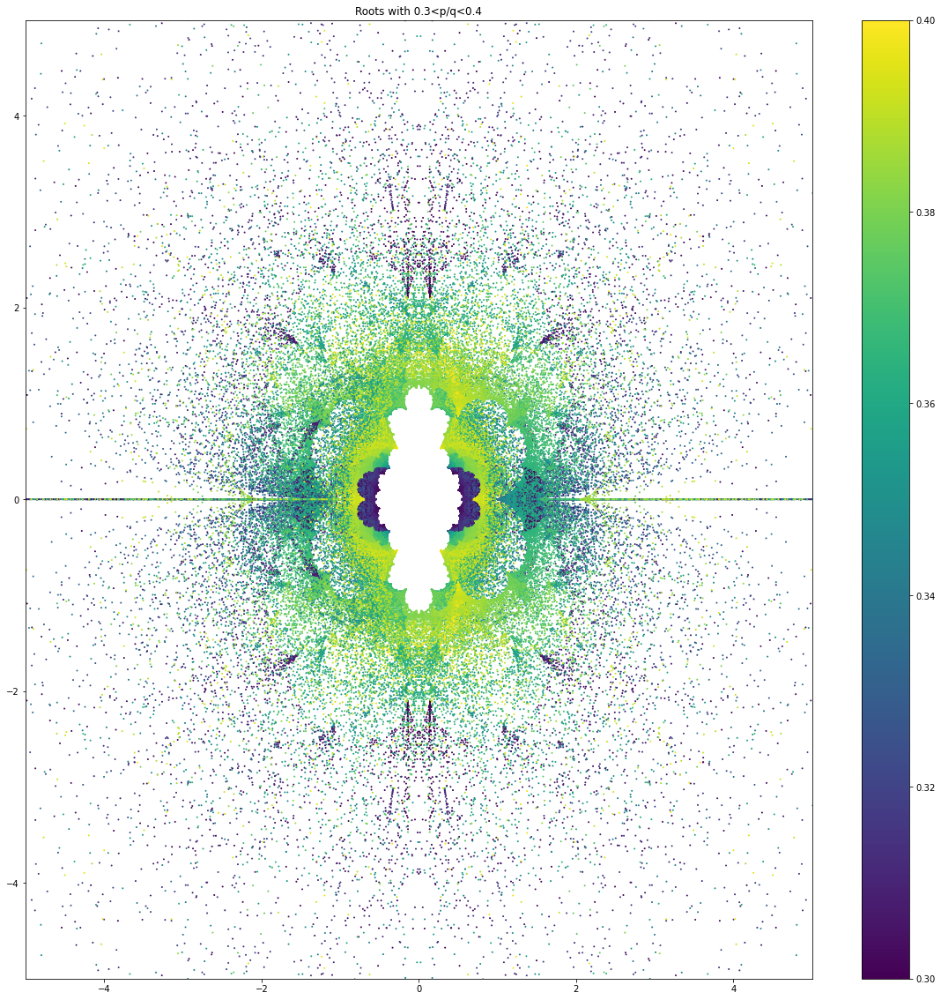

In [73]:
sort_by_ratio(ps,qs,xs,ys,min_ratio=0.3,max_ratio=0.4,lim=5)

[     0      0      0 ... 463829 463830 463831]
119799


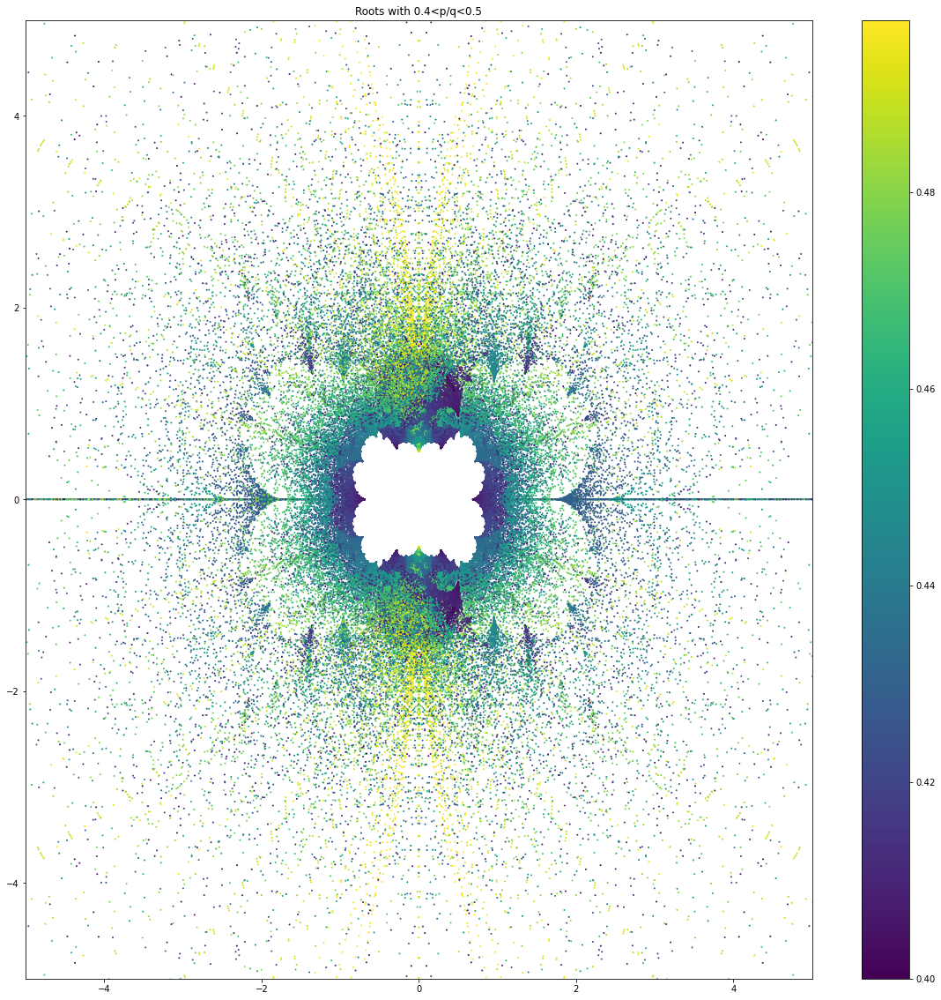

In [74]:
sort_by_ratio(ps,qs,xs,ys,min_ratio=0.4,max_ratio=0.5,lim=5)

[0 0 0 ... 0 0 0]
134466


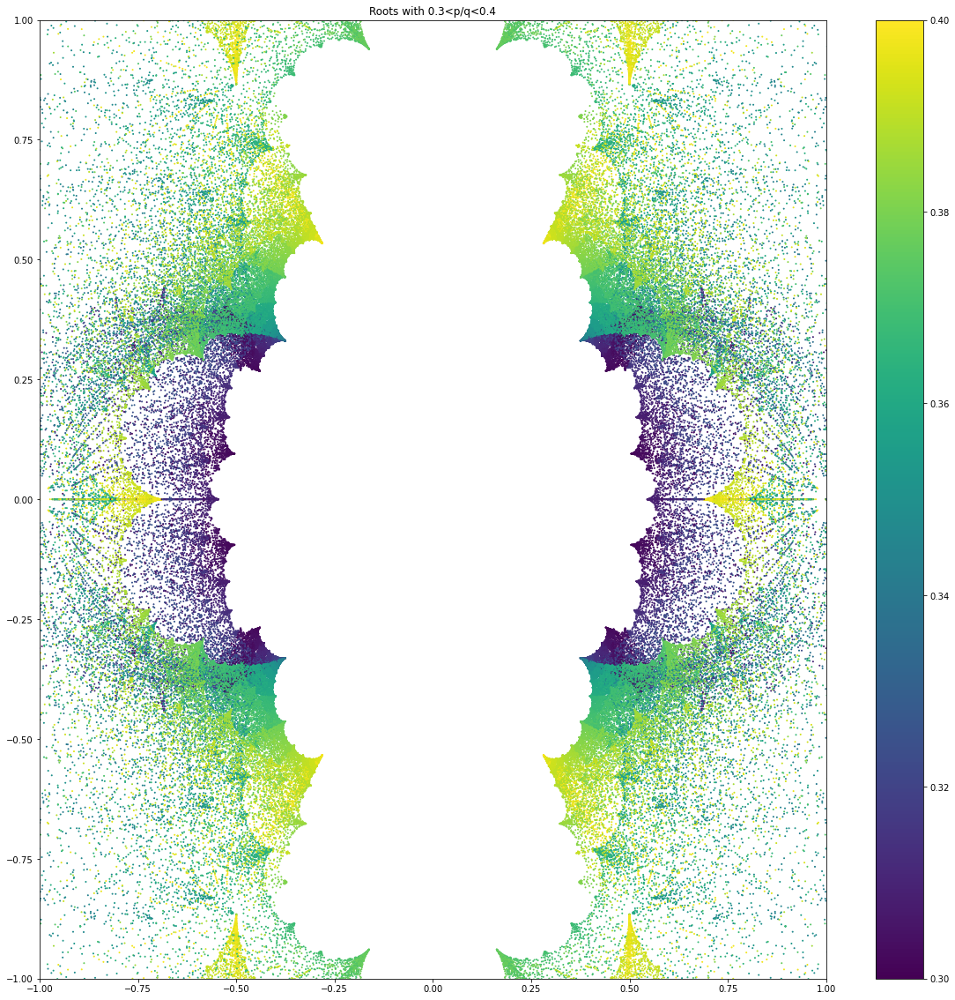

In [64]:
sort_by_ratio(ps,qs,xs,ys,min_ratio=0.3,max_ratio=0.4)

[0 0 0 ... 0 0 0]
134466


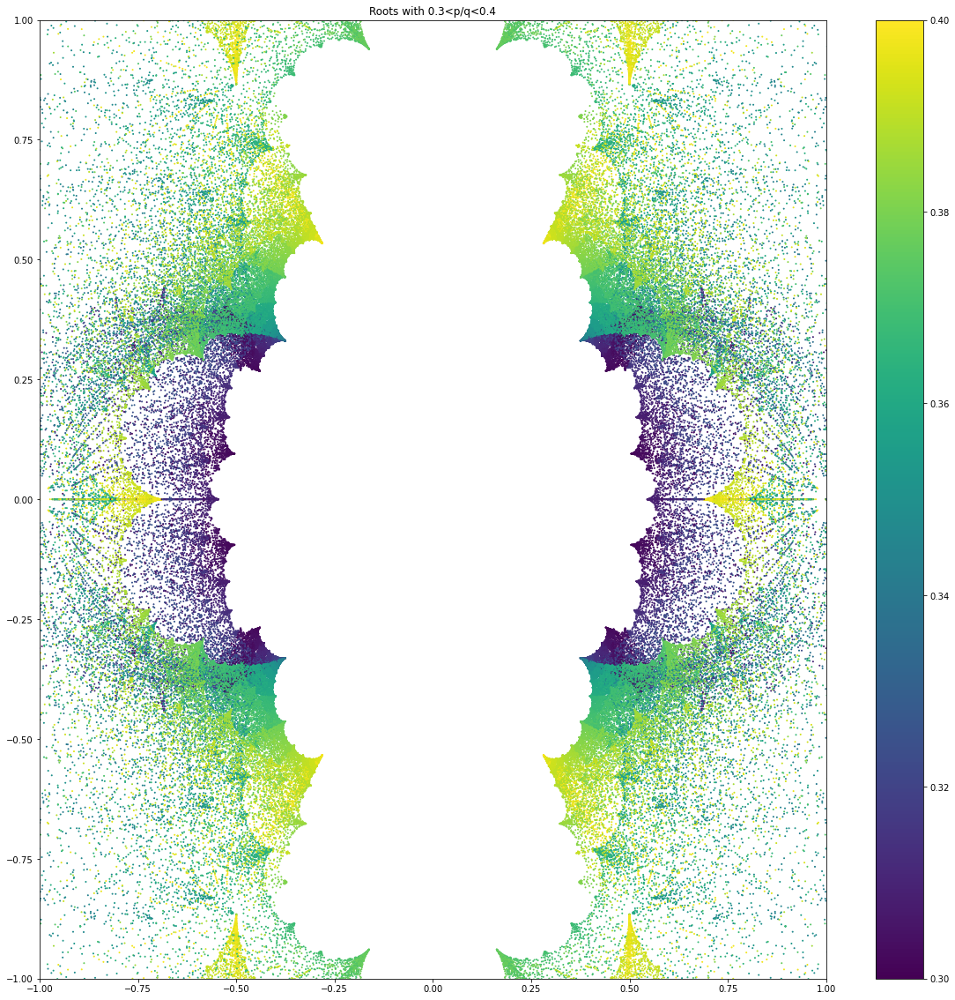

In [64]:
sort_by_ratio(ps,qs,xs,ys,min_ratio=0.3,max_ratio=0.4)

[0 1 2 ... 0 0 0]
149323


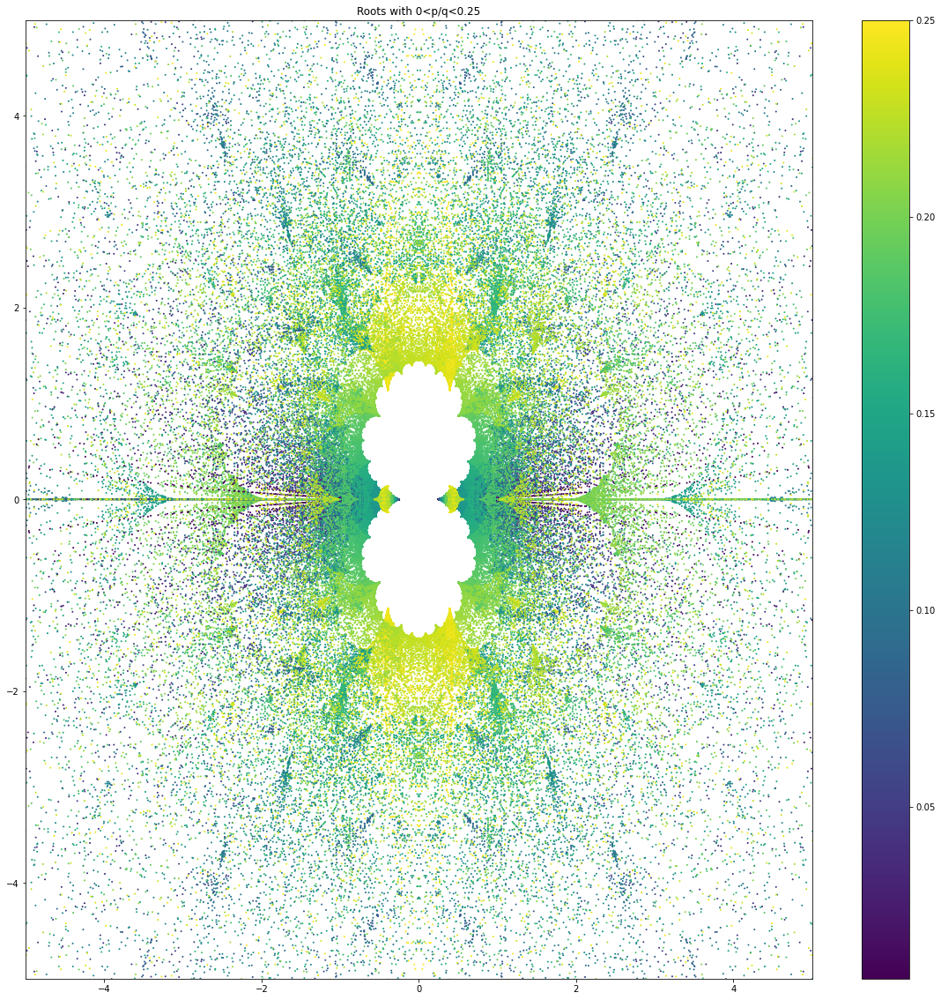

In [78]:
sort_by_ratio(ps,qs,xs,ys,min_ratio=0,max_ratio=0.25,lim=5)

[0 0 2 ... 0 0 0]
27164


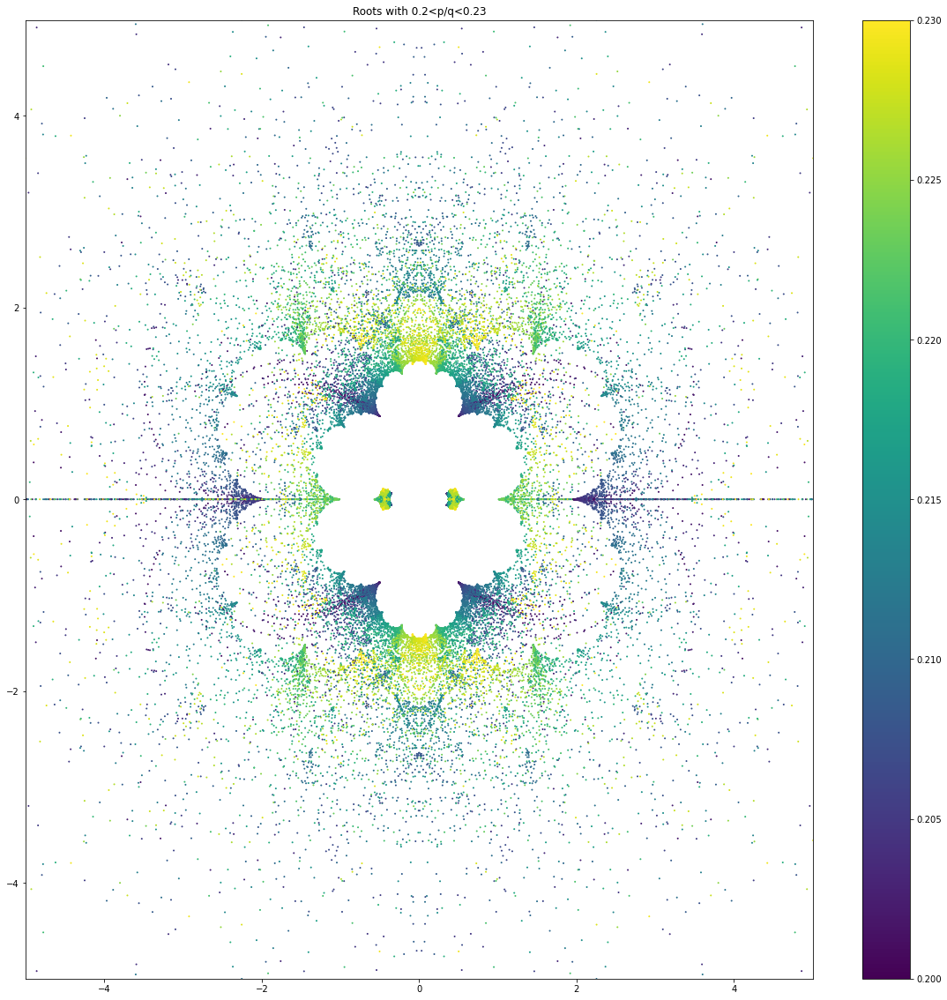

In [81]:
sort_by_ratio(ps,qs,xs,ys,min_ratio=0.20,max_ratio=0.23,lim=5)

[0 0 0 ... 0 0 0]
52354


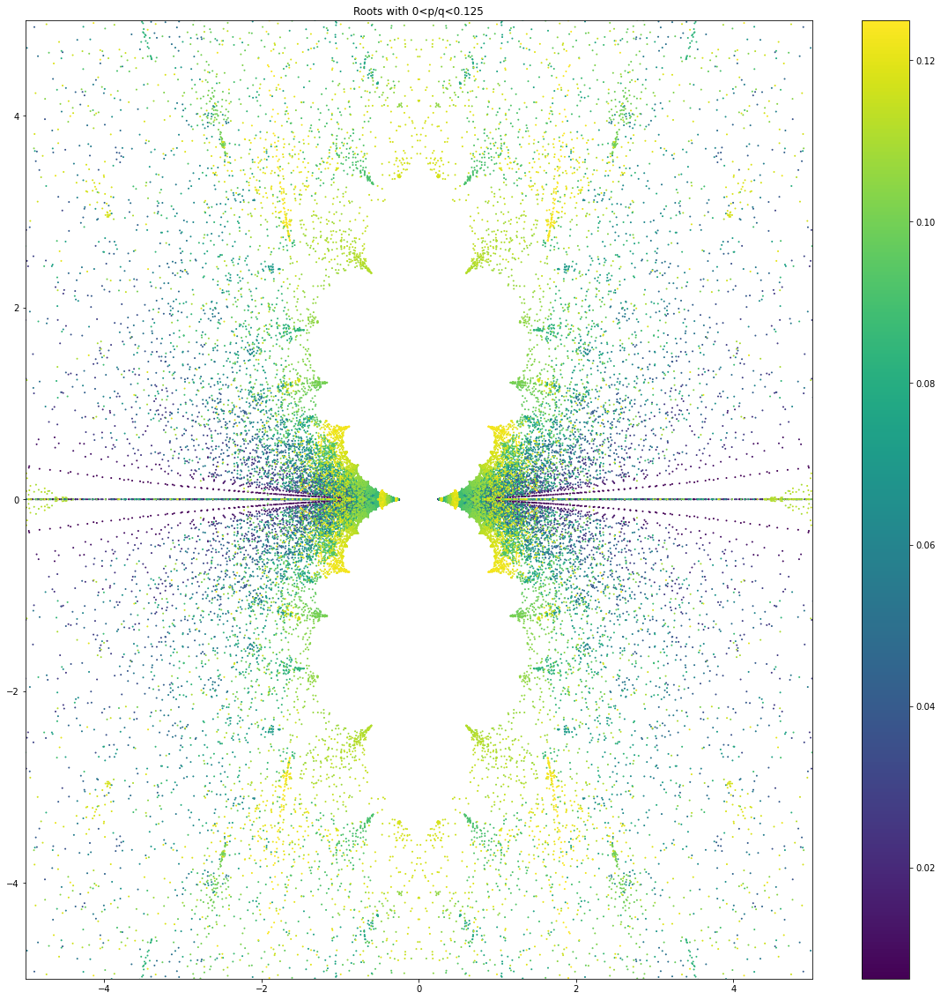

In [79]:
sort_by_ratio(ps,qs,xs,ys,min_ratio=0,max_ratio=0.125,lim=5)

[0 1 2 ... 0 0 0]
209572


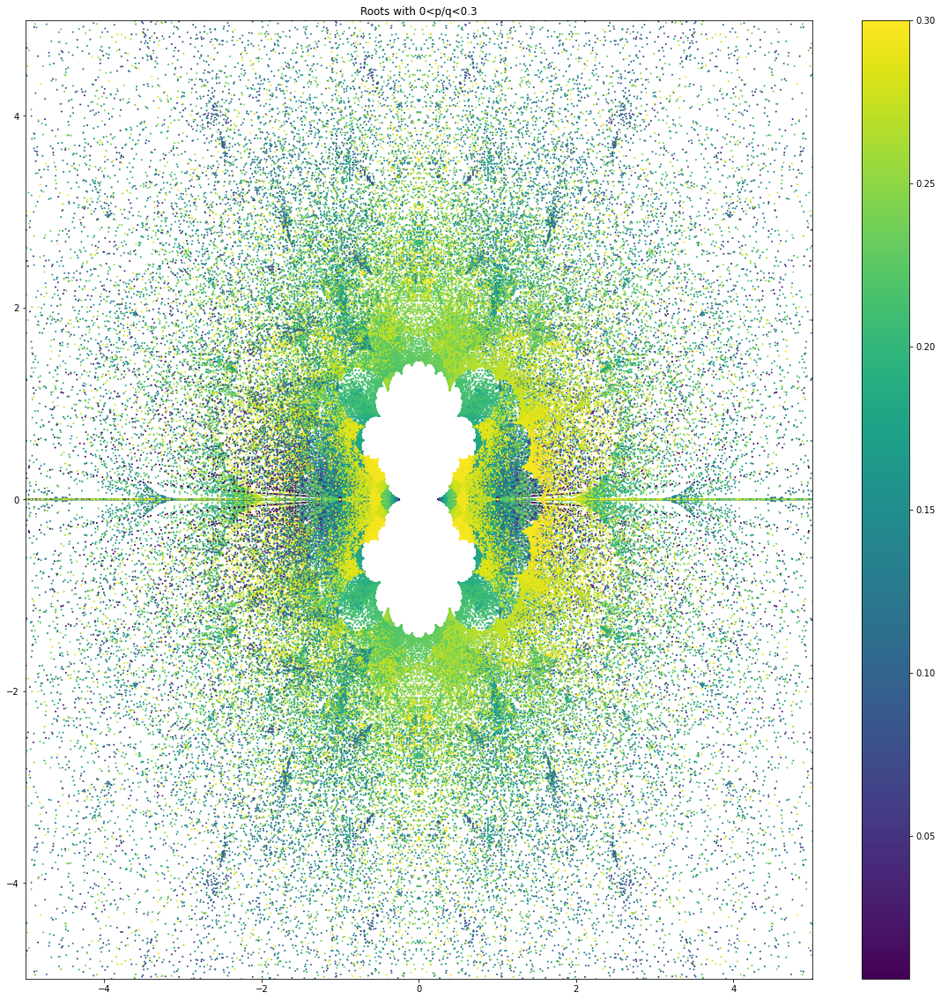

In [80]:
sort_by_ratio(ps,qs,xs,ys,min_ratio=0,max_ratio=0.3,lim=5)

[0 1 2 ... 0 0 0]
209572


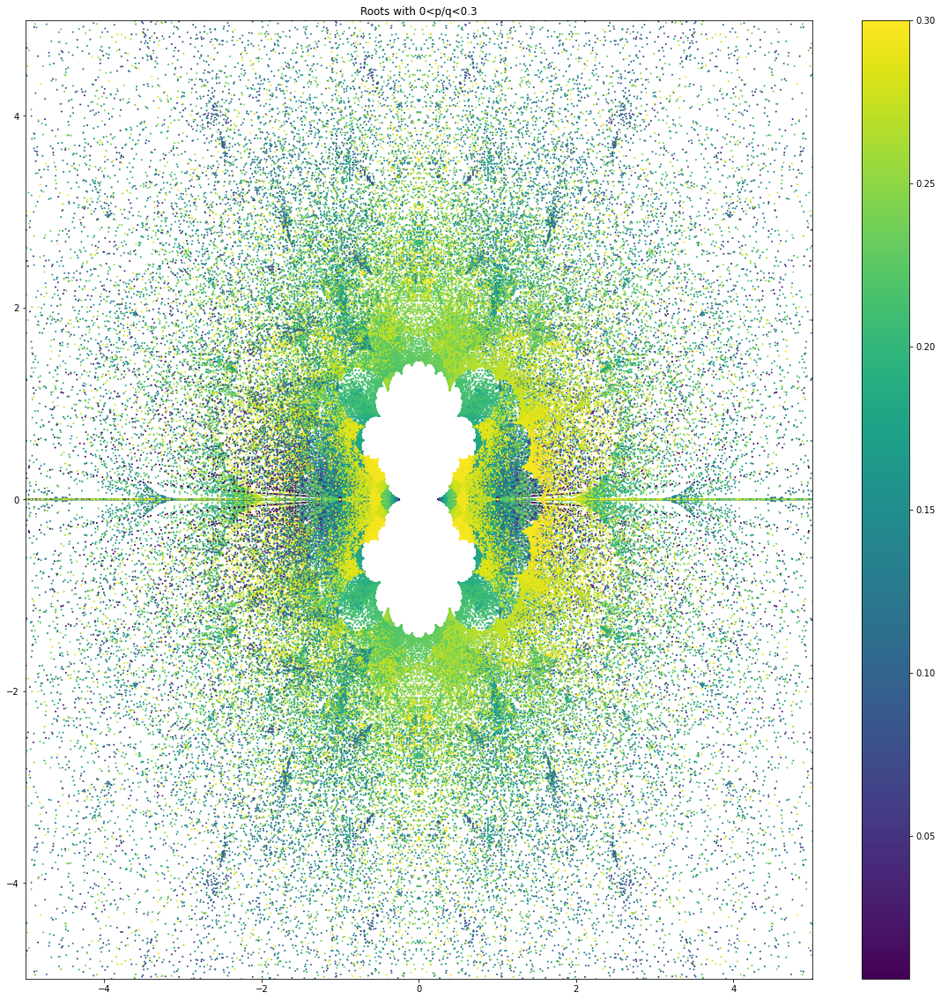

In [80]:
sort_by_ratio(ps,qs,xs,ys,min_ratio=0,max_ratio=0.3,lim=5)

In [ ]:
fig, axs = plt.subplots(1,figsize=(20,20))
s = axs.scatter(xs,ys, c=qs, s=1)
lim = 1
plt.xlim(-lim,lim)
plt.ylim(-lim,lim)
fig.colorbar(s)